### Laboratorium 6 - część badawcza

W pakiecie OpenCV wszystkie zadania związane z detekcją i opisem punktów kluczowych realizowane są przez zestaw specjalnych klas, dla których bazową jest `cv::Feature2D`. Jedną z wielu pochodnych tej klasy jest interesująca nas na zajęciach `cv::SIFT`, z której dokumentacją należy się zapoznać.  
Najważniejsze, co trzeba wiedzieć:
1. do konstrukcji obiektu SIFT służy metoda [`cv2.SIFT_create`](https://docs.opencv.org/4.x/d7/d60/classcv_1_1SIFT.html#ad337517bfdc068ae0ba0924ff1661131) - to do niej przekazujemy parametry detektora (w dokumentacji występuje jako `cv::SIFT::create`);
2. obsługujemy detektor przez interfejs `cv::Feature2D`, konkretnie metody [`detect`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#aa4e9a7082ec61ebc108806704fbd7887) do detekcji punktów kluczowych oraz [`compute`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#ab3cce8d56f4fc5e1d530b5931e1e8dc0) do obliczania ich deskryptorów (opcjonalnie `detectAndCompute`).

Schemat użycia:
```python
sift_instance = cv2.SIFT_create()
# 'image' powinno być obrazem jednokanałowym (jeśli nie, zostanie zastosowane cvtColor z flagą COLOR_BGR2GRAY)
keypoints = sift_instance.detect(image)
keypoints, descriptors = sift_instance.compute(image, keypoints)
```

`keypoints` jest listą obiektów specjalnego typu `cv2.KeyPoint`, która **jest modyfikowana** przez `SIFT::compute`!  
`descriptors` jest natomiast macierzą float32 o wymiarach NxK, gdzie N jest liczbą punktów kluczowych, a K jest liczbą obliczonych cech.

Warto również zapoznać się z funkcją [`cv2.drawKeypoints`](https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920) w kontekście prezentacji wyników. Zwróć uwagę na flagi sterujące rysowaniem - szczególnie użyteczna jest `cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS`.

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

#### Zadanie 1

Przetestuj wpływ podstawowych parametrów detektora SIFT (`contrastThreshold` i `edgeThreshold`) na uzyskiwane punkty kluczowe (liczność, lokalizacja, rozmiar), korzystając z obrazów `cells` i `lena`. Pamiętaj że ich działanie jest odwrotne (tzn. jeden odsiewa cechy "mniejsze niż", a drugi "większe niż").

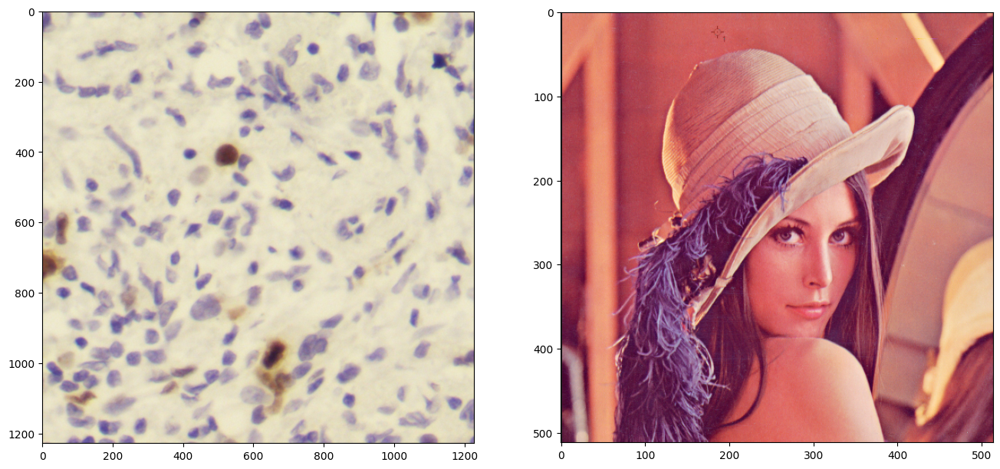

In [2]:
cells = cv2.imread("p1_0308_7.jpg")
lena = cv2.imread("Lena.jpg")
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(cells[..., ::-1])
a2.imshow(lena[..., ::-1])

- `contrastThreshold` - eliminates weak keypoints (regions with low contrast)
    - low contrast threshold - removes less keypoints (removes keypoints with constrast below threshold) 
    - high contrast threshold - removes more keypoints (removes keypoints with constrast below threshold)
- `edgeThreshold` - eliminates keypoints that are edge-like
    - low edge threshold - removes more keypoints (values above threshold are removed)
    - high edge threshold - removes less keypoints (values above threshold are removed)


In [14]:
def plot_sift_grid(
    image, contrast_thresholds=[0.01, 0.04, 0.08], edge_thresholds=[5, 10, 20]
):
    # Convert to grayscale if needed
    if len(image.shape) == 3:
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    else:
        gray = image

    fig, axes = plt.subplots(
        len(contrast_thresholds), len(edge_thresholds), figsize=(15, 15)
    )
    fig.suptitle(
        "SIFT Keypoints Grid Search\nRows: contrastThreshold, Columns: edgeThreshold"
    )

    test = np.zeros_like(gray)

    for i, ct in enumerate(contrast_thresholds):
        for j, et in enumerate(edge_thresholds):
            sift = cv2.SIFT_create(contrastThreshold=ct, edgeThreshold=et)

            keypoints = sift.detect(gray, None)
            img_with_kp = cv2.drawKeypoints(
                image,
                keypoints,
                outImage=test,
                flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS,
            )

            axes[i, j].imshow(img_with_kp[..., ::-1])
            axes[i, j].set_title(f"ct={ct}, et={et}\nkp={len(keypoints)}")
            axes[i, j].axis("off")

    plt.tight_layout()
    plt.show()

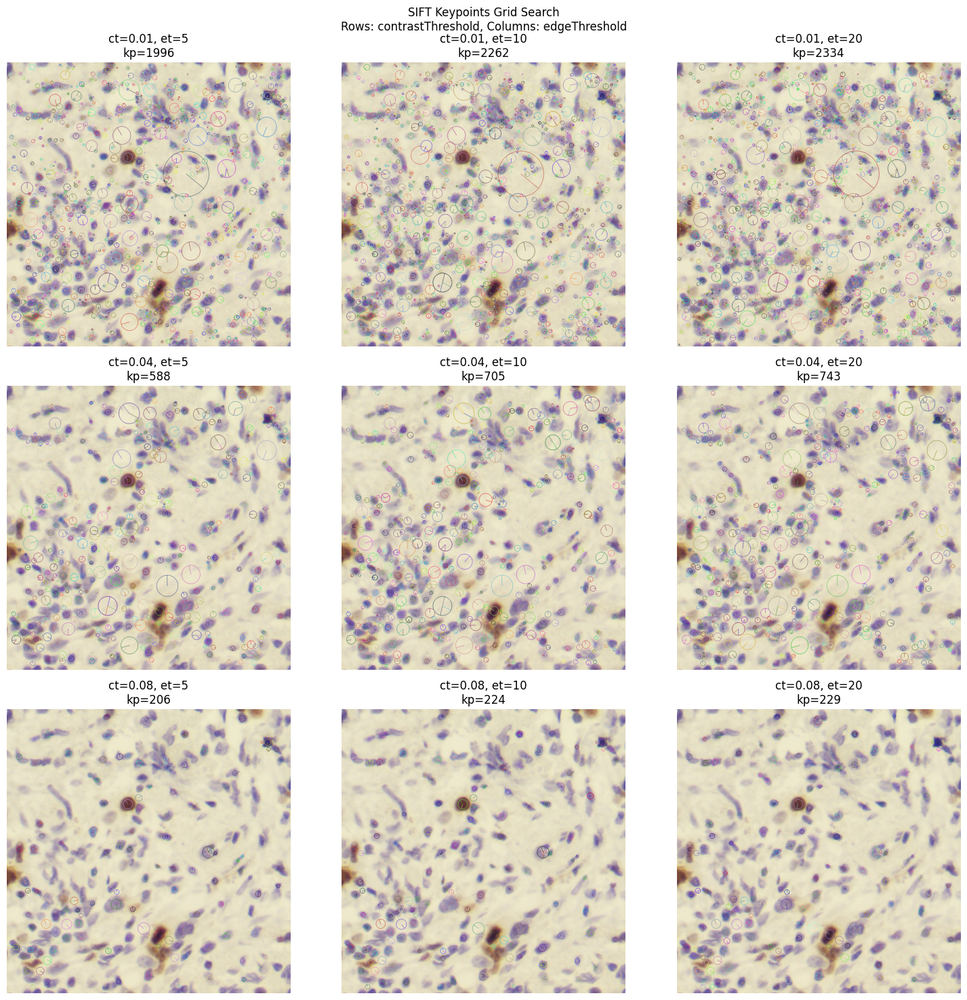

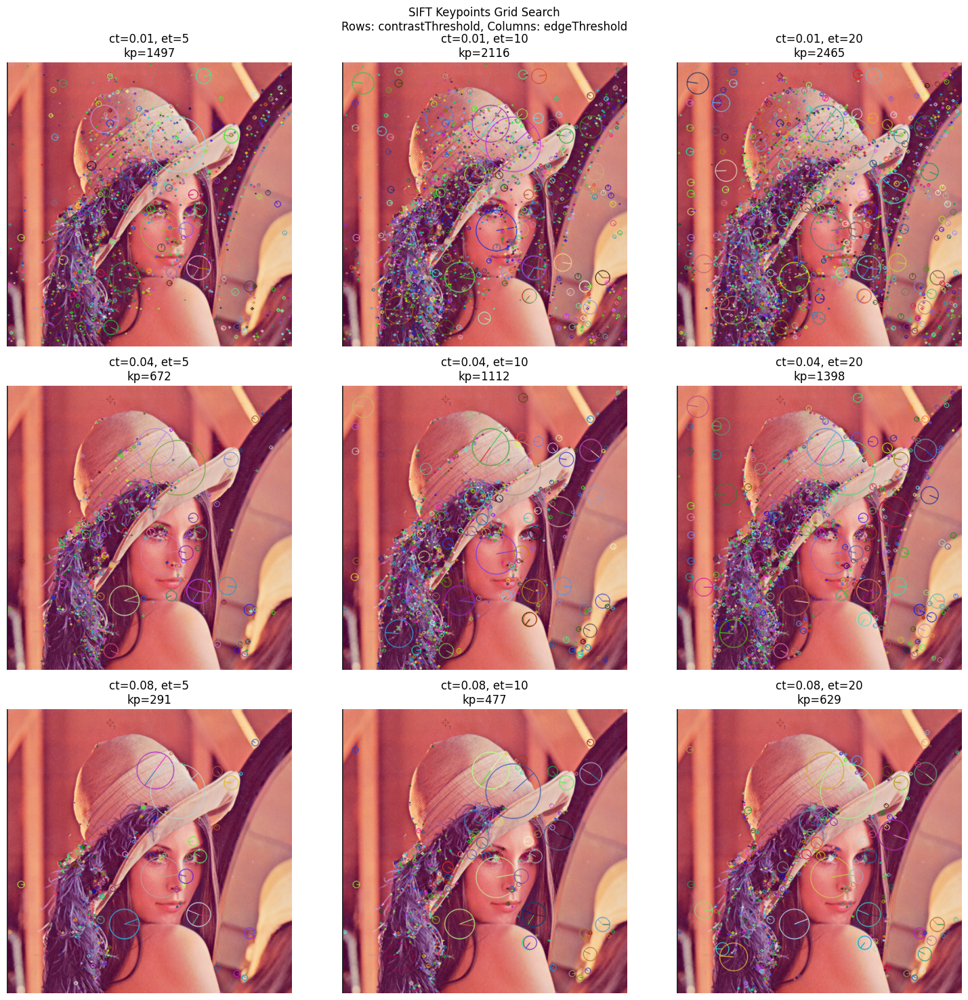

In [15]:
# Test on both images
plot_sift_grid(cells)
plot_sift_grid(lena)

#### Zadanie 2

Detektor SIFT jest w teorii niezmienniczy względem translacji, rotacji czy zmiany skali. Przetestuj te własności w praktyce, sprawdzając stabilność punktów wykrywanych na obróconej i przeskalowanej wersji obrazów `cells` i `lena`. Dokonaj oceny wizualnie, sprawdzając zachowanie detektora dla kilku wybranych rotacji i skal (**nie** grid search).

_Co świadczy o stabilności i niezmienniczości detektora?_

In [16]:
def rotate(image: np.ndarray, angle: float, scale: float = 1.0) -> np.ndarray:
    center = (image.shape[0] // 2, image.shape[1] // 2)
    rmat = cv2.getRotationMatrix2D(center, angle, scale)
    return cv2.warpAffine(
        image, rmat, (image.shape[0], image.shape[1]), flags=cv2.INTER_CUBIC
    )

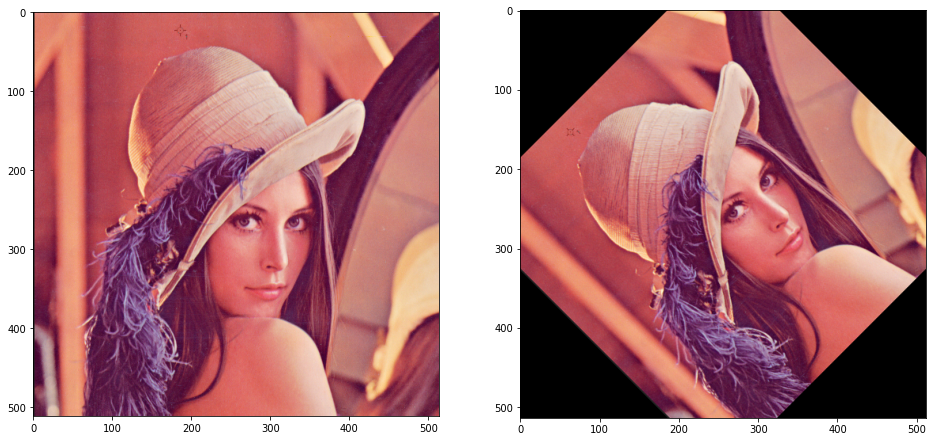

In [4]:
# przykład dla Leny, pamiętaj o cells!
lena_rot = rotate(lena, 45.0, scale=0.9)
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(lena[..., ::-1])
a2.imshow(lena_rot[..., ::-1])

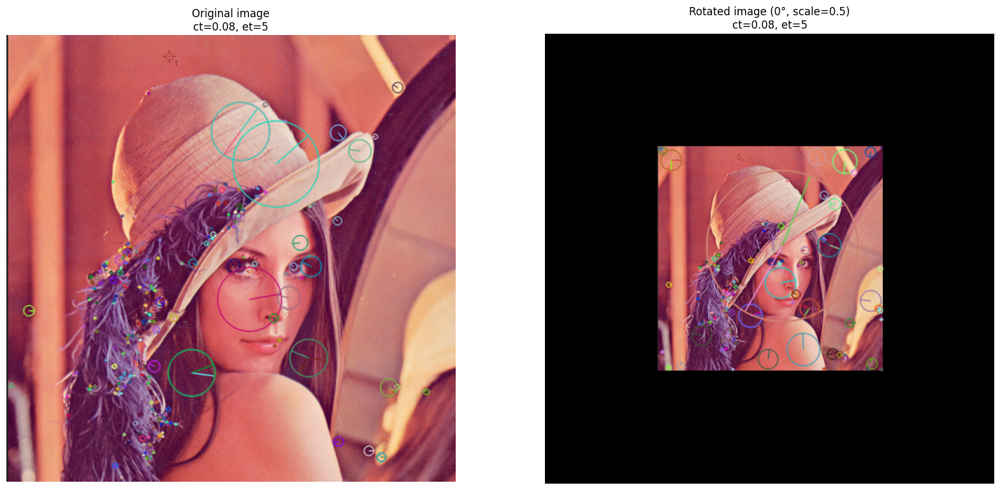

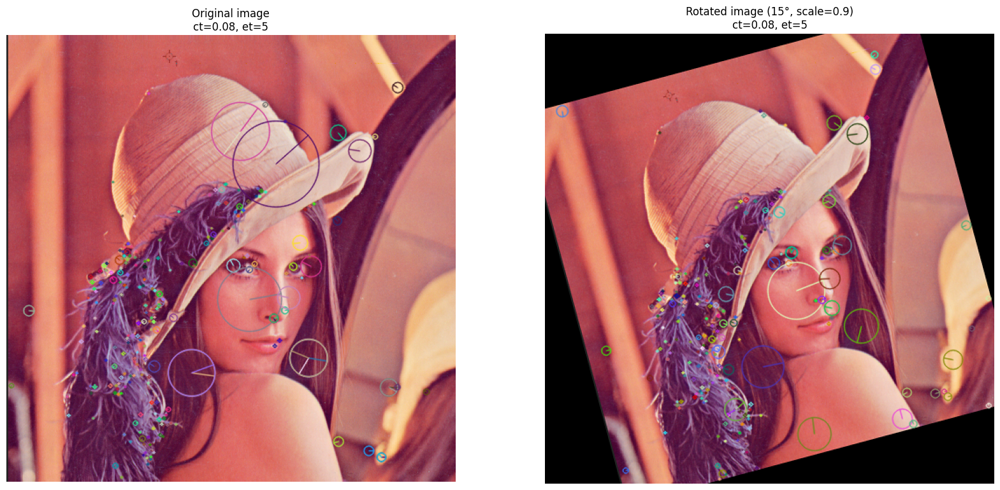

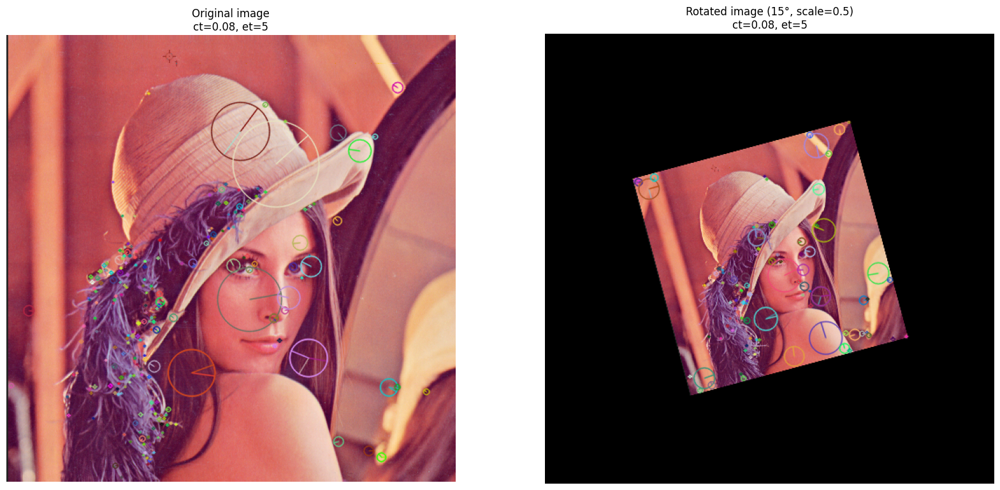

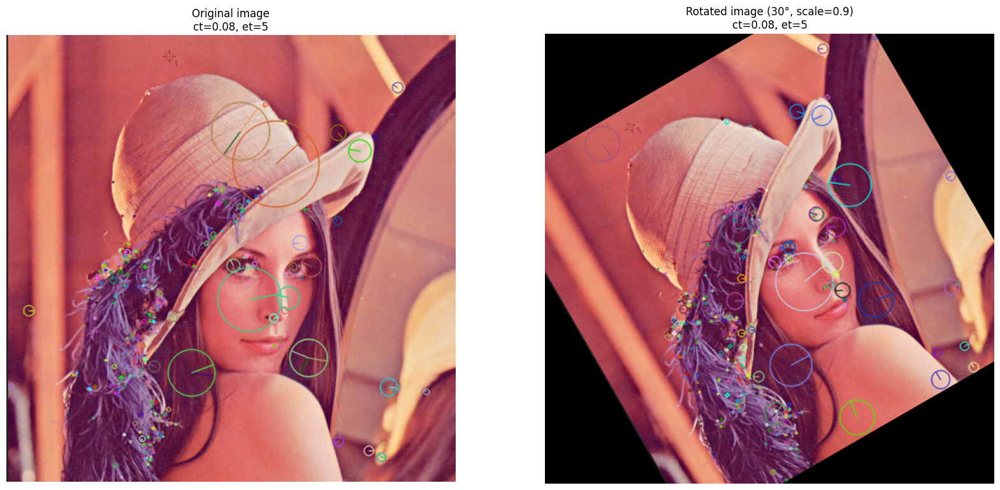

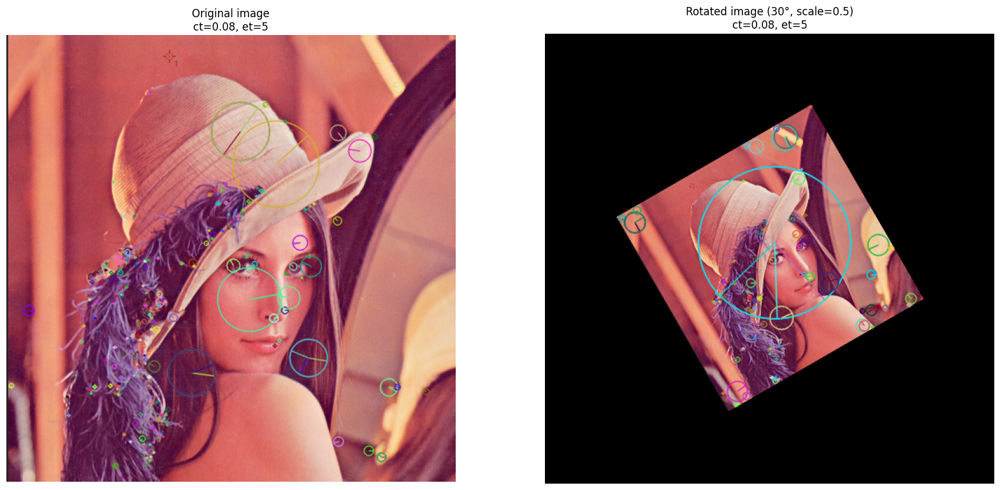

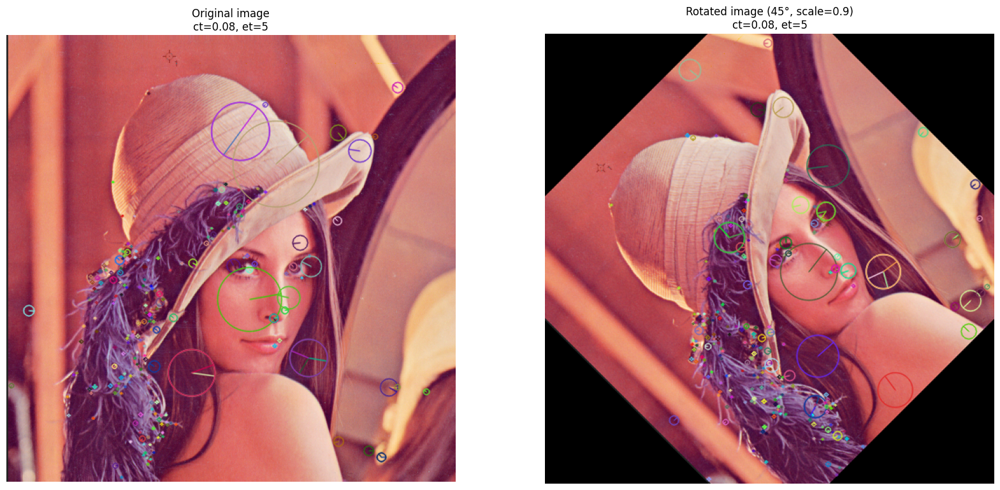

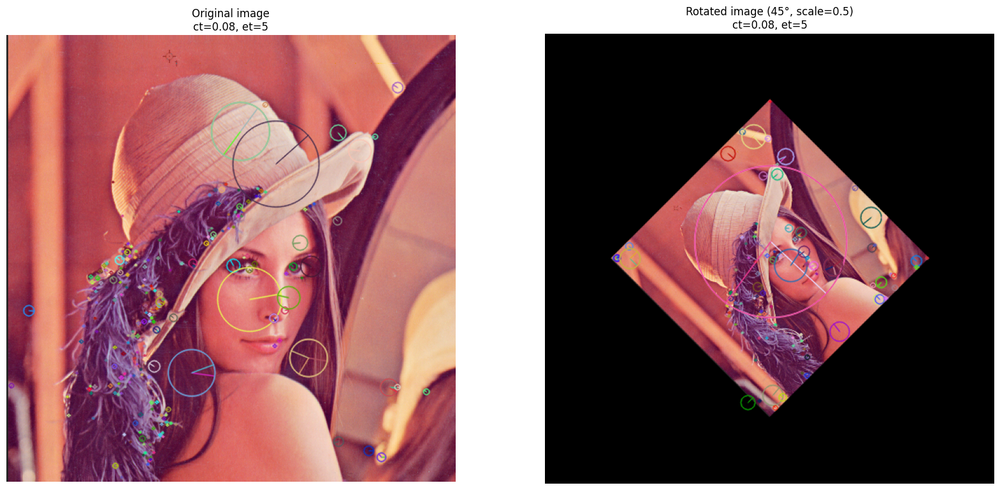

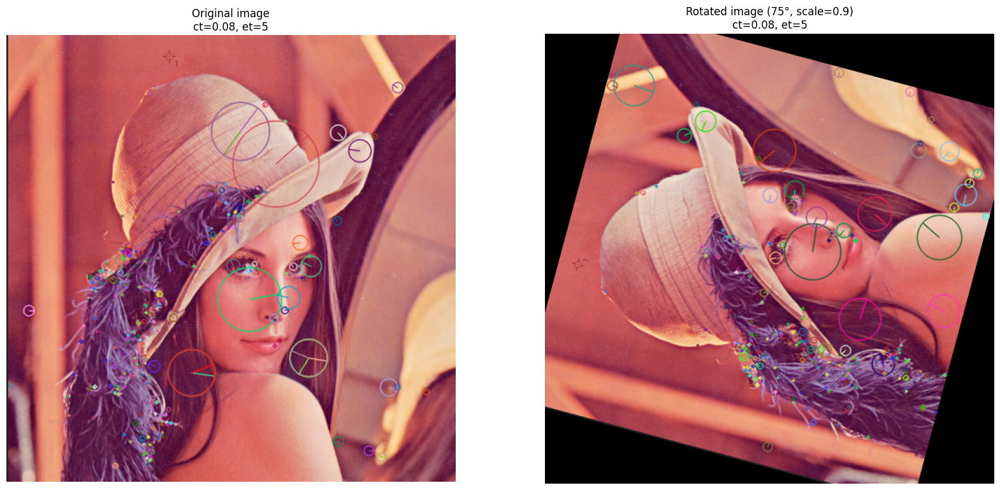

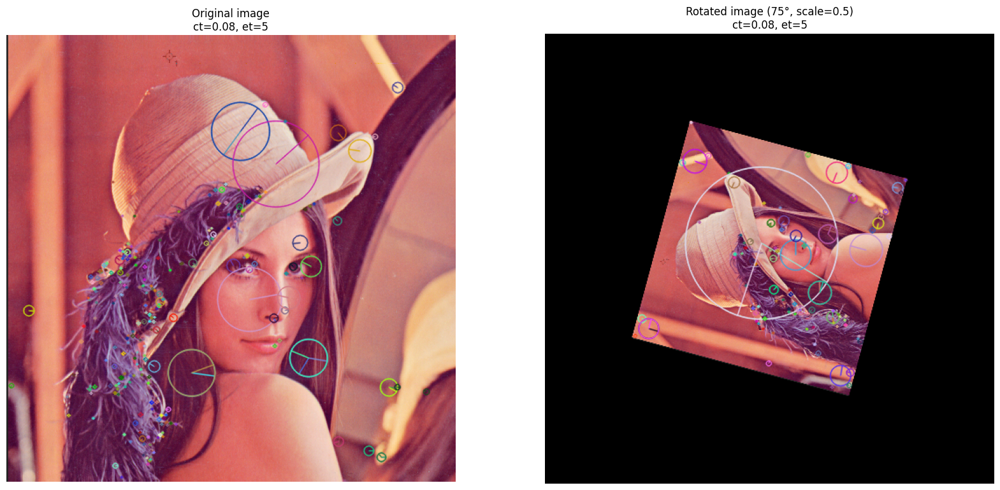

In [29]:
ct = 0.08
et = 5

lena_rot = rotate(lena, 45.0, scale=0.9)


def get_sift_keypoints(
    image: np.ndarray, contrast_threshold: float, edge_threshold: float
) -> list[cv2.KeyPoint]:
    sift = cv2.SIFT_create(
        contrastThreshold=contrast_threshold, edgeThreshold=edge_threshold
    )
    return sift.detect(image, None)


def get_sift_keypoint_img(
    keypoints: list[cv2.KeyPoint],
    image: np.ndarray,
) -> np.ndarray:
    out_img = np.zeros_like(image)
    img_with_kp = cv2.drawKeypoints(
        image,
        keypoints,
        outImage=out_img,
        flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS,
    )

    return img_with_kp


def plot_sift_comparison(
    orig: np.ndarray, rot: np.ndarray, ct: float, et: float
) -> None:
    plt.figure(figsize=(20, 10))
    plt.subplot(121)
    plt.imshow(orig[..., ::-1])
    plt.title(f"Original image\nct={ct}, et={et}")
    plt.axis("off")

    plt.subplot(122)
    plt.imshow(rot[..., ::-1])
    plt.title(f"Rotated image ({angle}°, scale={scale})\nct={ct}, et={et}")
    plt.axis("off")


angle_scale_pairs = [
    (0, 0.5),
    (15, 0.9),
    (15, 0.5),
    (30, 0.9),
    (30, 0.5),
    (45, 0.9),
    (45, 0.5),
    (75, 0.9),
    (75, 0.5),
]


for angle, scale in angle_scale_pairs:
    lena_rot = rotate(lena, angle, scale=scale)
    orig_keypoints = get_sift_keypoints(lena, ct, et)
    rot_keypoints = get_sift_keypoints(lena_rot, ct, et)
    orig = get_sift_keypoint_img(orig_keypoints, lena)
    rot = get_sift_keypoint_img(rot_keypoints, lena_rot)
    plot_sift_comparison(orig, rot, ct, et)

#### Zadanie 3

Dane są obrazy `coke` i `table`. Wykorzystaj metodologię parowania punktów kluczowych do znalezienia wystąpienia puszki z Colą na stole. To zadanie jest podzielone na dwie części - czytaj dalej.

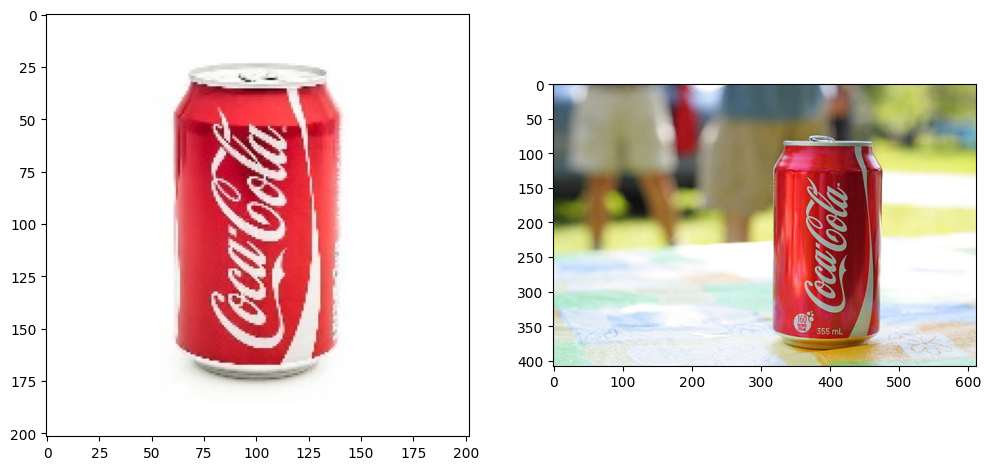

In [31]:
coke = cv2.imread("coke.jpg")
table = cv2.imread("coke-table.jpg")
f, (a1, a2) = plt.subplots(1, 2, figsize=(12, 12))
a1.imshow(coke[..., ::-1])
a2.imshow(table[..., ::-1])

##### Zadanie 3a

Wykonaj detekcję punktów kluczowych i ich parowanie z użyciem dowolnego matchera. Wykonaj filtrację znalezionych par po dystansie - co obserwujesz, zmieniając próg?

In [42]:
def get_sift_keys_and_descriptors(
    image: np.ndarray, contrast_threshold: float, edge_threshold: float
) -> tuple[list[cv2.KeyPoint], np.ndarray]:
    sift = cv2.SIFT_create(
        contrastThreshold=contrast_threshold, edgeThreshold=edge_threshold
    )
    keypoints = sift.detect(image, None)
    return sift.compute(image, keypoints)

- keypoint descriptor - 128 features - gradients in 8x8 grid with 4 orientations

In [55]:
def filter_matches(matches: list, threshold: float = 0.75) -> list:
    """
    Filter matches using Lowe's ratio test
    Args:
        matches: List of matches from knnMatch
        threshold: Threshold for Lowe's ratio test (default 0.75)
    Returns:
        List of good matches that pass the ratio test
    """
    good_matches = []
    for m, n in matches:  # m is best match, n is second best
        if m.distance < threshold * n.distance:
            good_matches.append(m)
    return good_matches

coke keypoints: 59
table keypoints: 143
coke descriptors: (59, 128)
table descriptors: (143, 128)
Found 59 matches


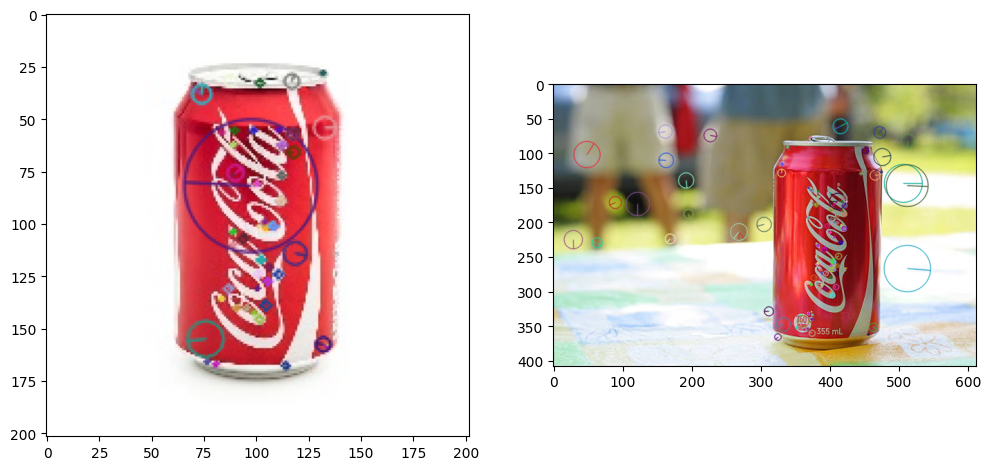

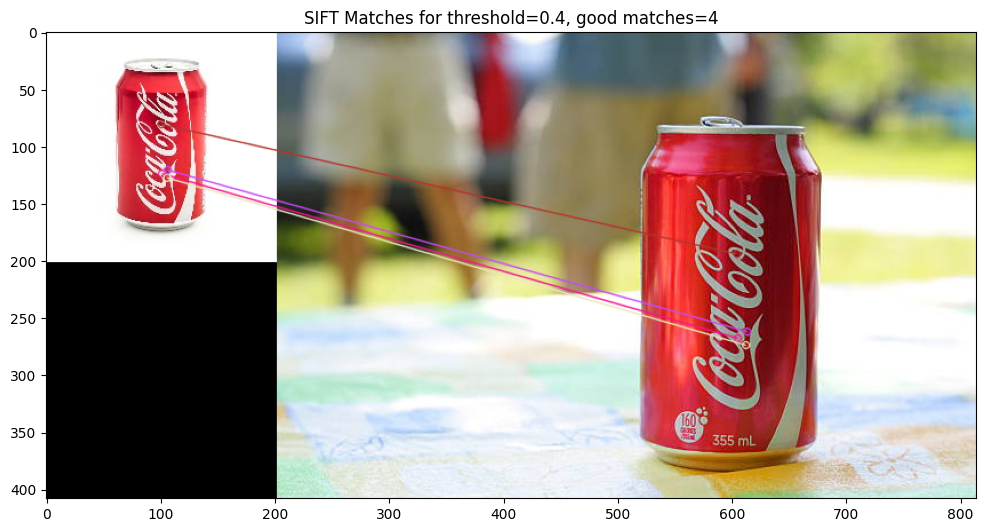

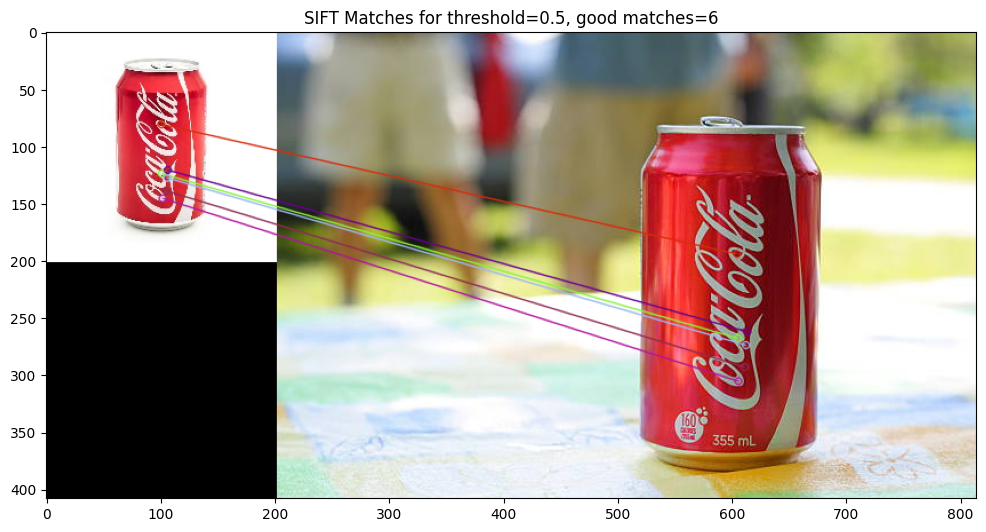

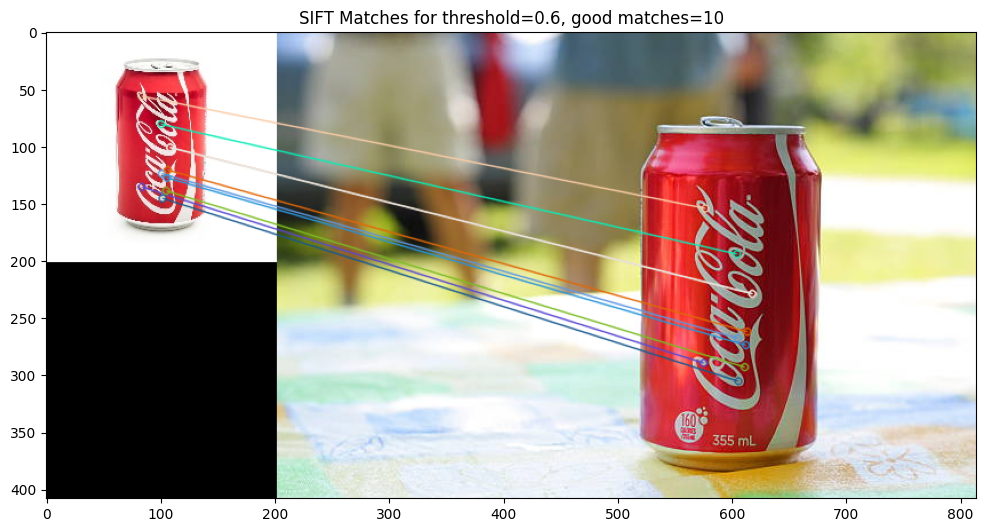

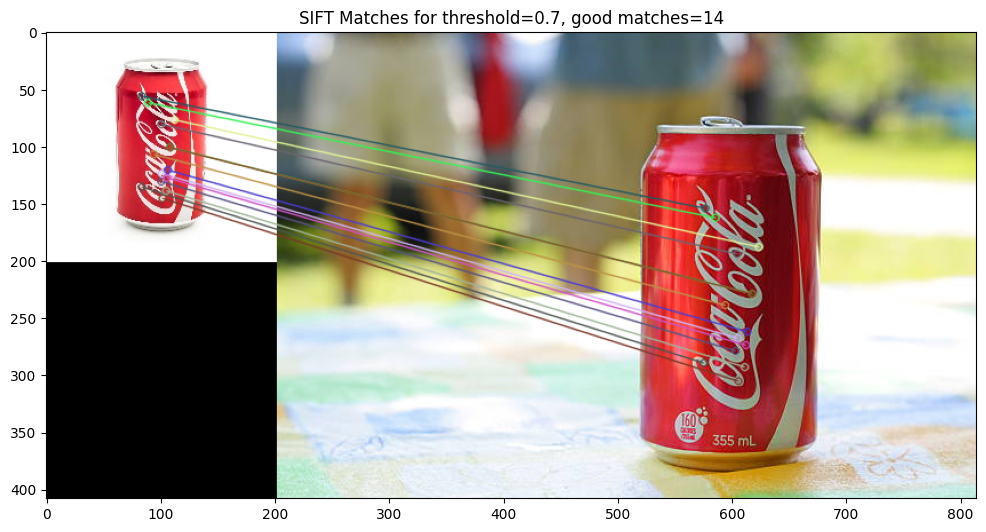

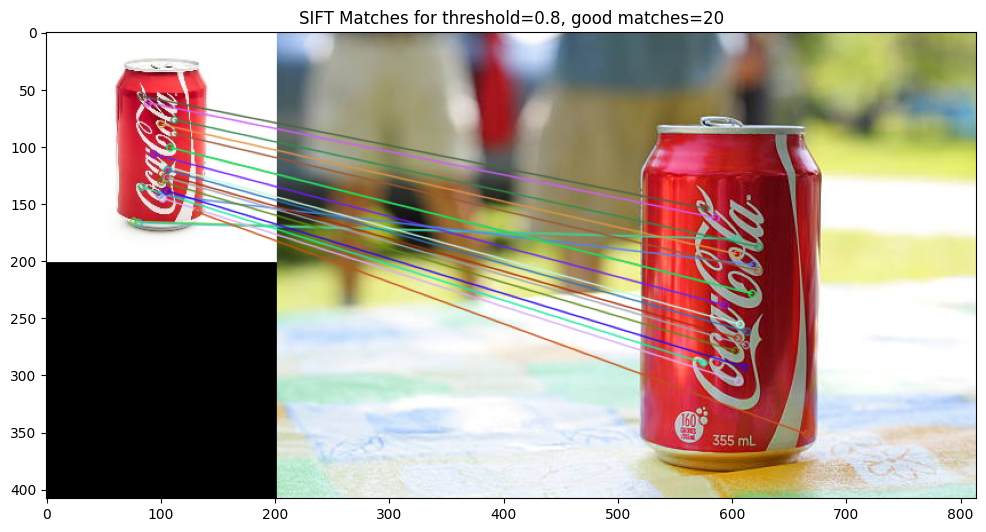

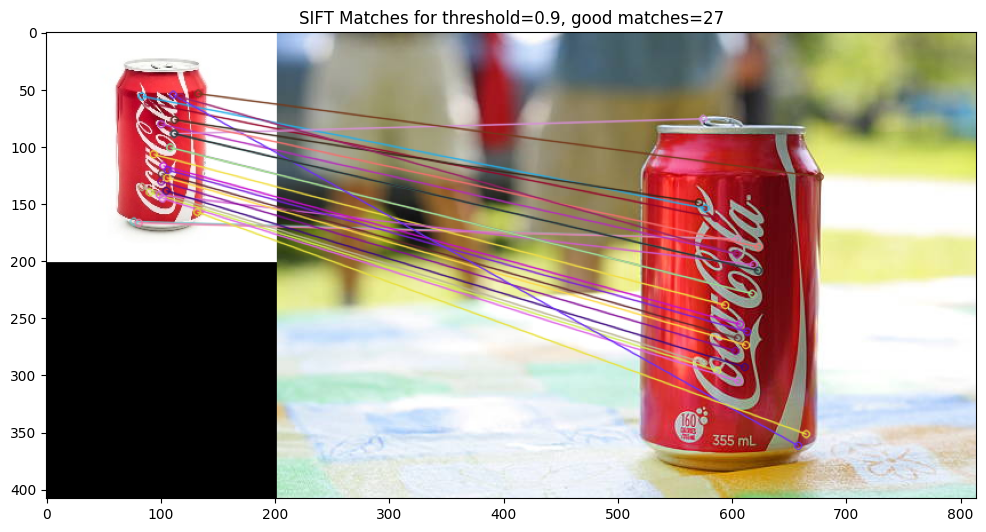

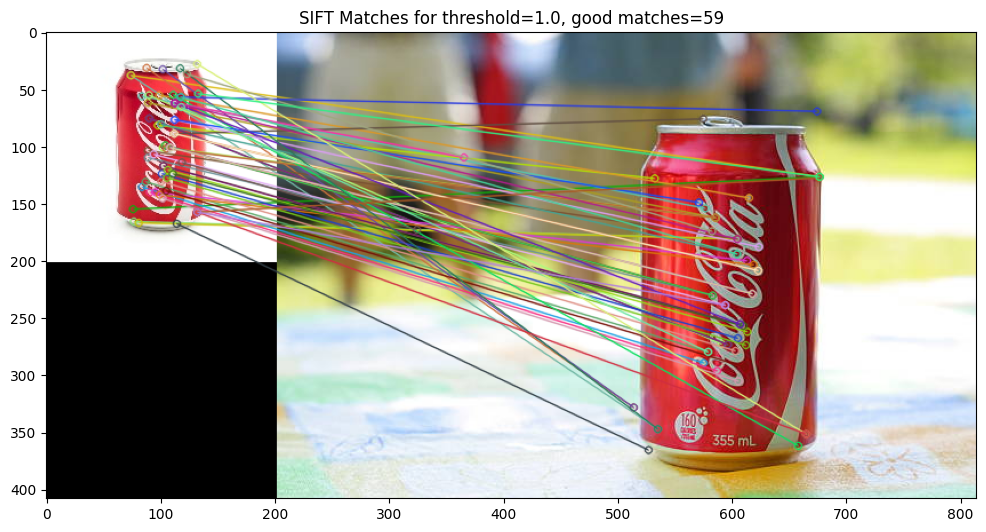

In [63]:
coke_sift = get_sift_keys_and_descriptors(coke, ct, et)
coke_img = get_sift_keypoint_img(coke_sift[0], coke)

table_sift = get_sift_keys_and_descriptors(table, ct, et)
table_img = get_sift_keypoint_img(table_sift[0], table)

# coke_sift[0] and table_sift[0] are keypoints
print(f"coke keypoints: {len(coke_sift[0])}")
print(f"table keypoints: {len(table_sift[0])}")

# coke_sift[1] and table_sift[1] are descriptors
print(f"coke descriptors: {coke_sift[1].shape}")
print(f"table descriptors: {table_sift[1].shape}")

matcher = cv2.BFMatcher()
matches = matcher.knnMatch(coke_sift[1], table_sift[1], k=2)

print(f"Found {len(matches)} matches")

f, (a1, a2) = plt.subplots(1, 2, figsize=(12, 12))
a1.imshow(coke_img[..., ::-1])
a2.imshow(table_img[..., ::-1])
plt.show()

thresholds = [0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

for threshold in thresholds:
    good_matches = filter_matches(matches, threshold=threshold)

    # Draw matches between images
    match_img = cv2.drawMatches(
        coke,
        coke_sift[0],
        table,
        table_sift[0],
        good_matches,
        outImg=np.zeros_like(coke),
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
    )

    plt.figure(figsize=(12, 12))
    plt.imshow(match_img[..., ::-1])  # Convert BGR to RGB for display
    plt.title(
        f"SIFT Matches for threshold={threshold}, good matches={len(good_matches)}"
    )
    plt.show()

##### Zadanie 3b

Znajdź transformację geometryczną dla par dopasowanych punktów, tak aby przekształcić `coke` (_train_) do geometrii `table` (_query_). Zademonstruj poprawność, zestawiając obok siebie przekształconą wersję `coke` oraz oryginalny `table`, bądź nanosząc jedno na drugie. Zidentyfikuj punkty, które znaleziona transformacja przekształca "dobrze", tzn. ich współrzędne po przekształceniu leżą w pobliżu odpowiadających im punktów z drugiego obrazu; nanieś je na obraz.

*Jak na wyniki wpływa wykrycie większej lub mniejszej liczby punktów kluczowych na etapie SIFT? W jakim stopniu filtracja poprawia rezultaty? Jak działa i jaką rolę w procesie parowania odgrywa RANSAC?*

Działanie RANSAC:
1. losowy wybór minimalnego zestawu punktów potrzebych do obliczenia modelu (np. macierzy homografii)
2. obliczenie modelu na podstawie wybranych punktów
3. Obliczenie ile pozostałych punktów pasuje do tego modelu (tzw. inliers)
4. Powtórzenie procesu wiele razy dla różnych losowych zestawów punktów
5. Wybranie modelu, który ma najwięcej inliers


Found 14 good matches with threshold 0.7


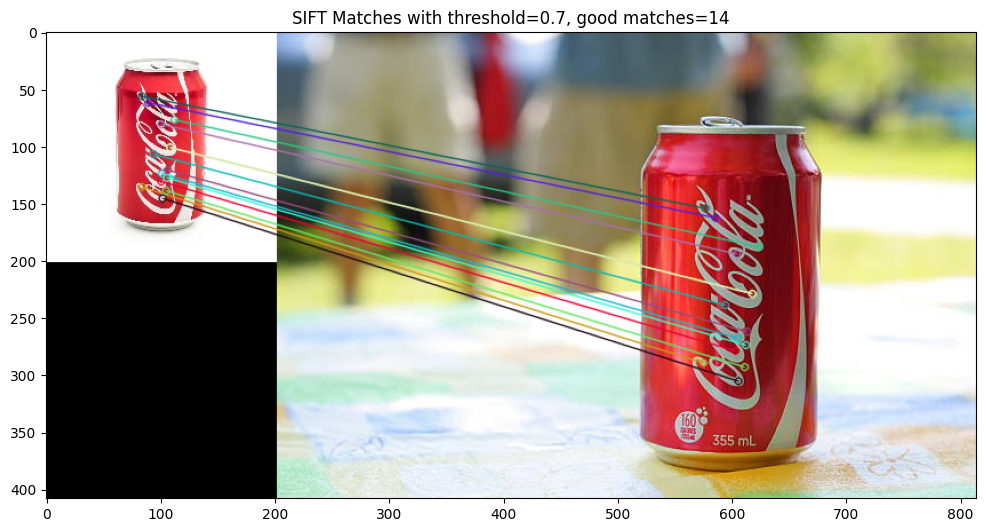

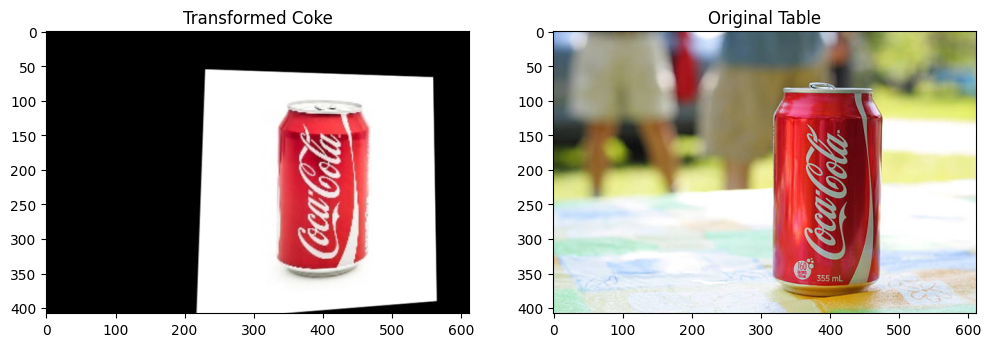

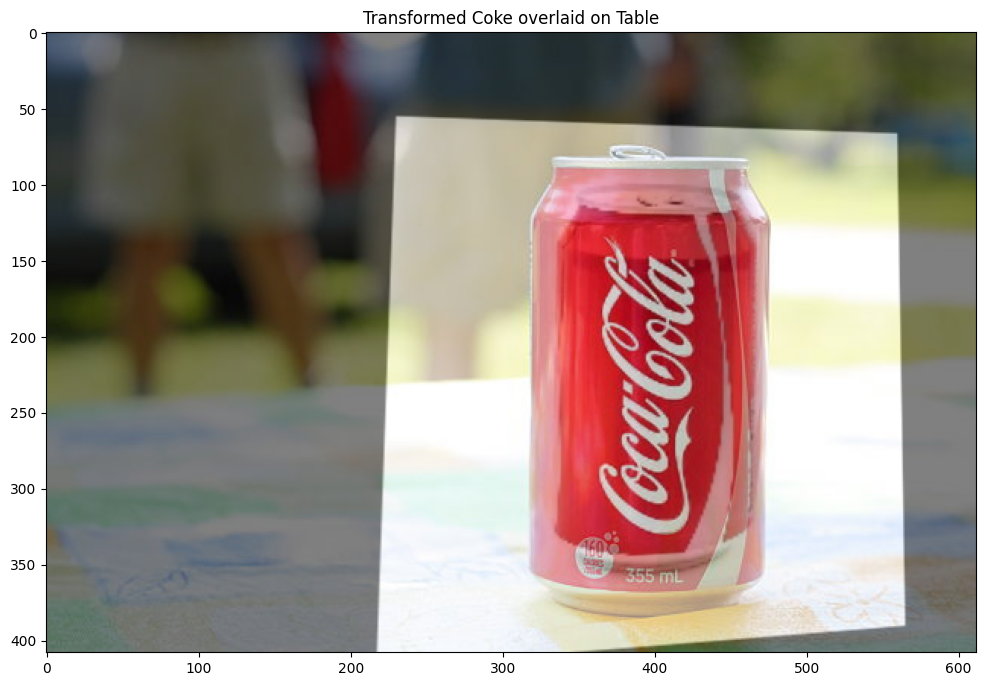

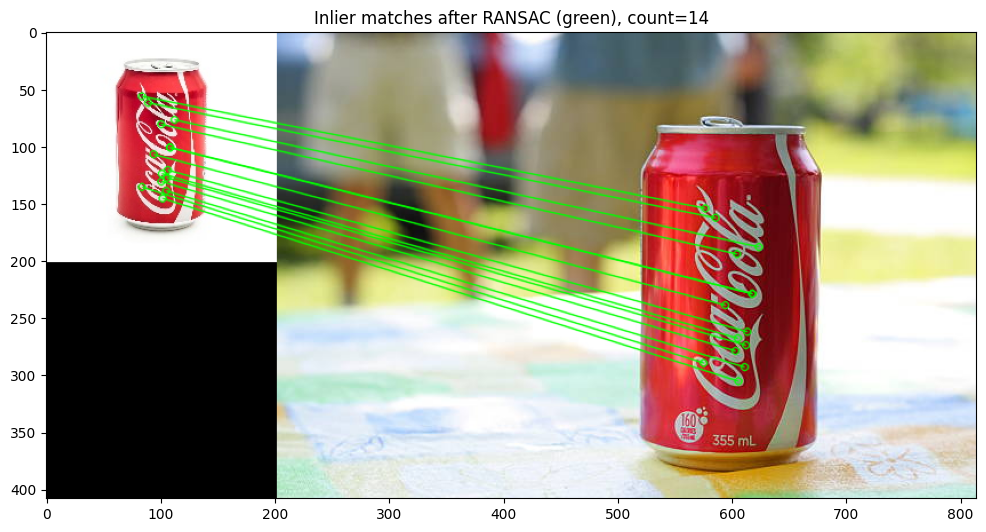

In [69]:
# Filter matches with threshold 0.7
good_matches = filter_matches(matches, threshold=0.7)

print(f"Found {len(good_matches)} good matches with threshold 0.7")

# Draw matches between images
match_img = cv2.drawMatches(
    coke,
    coke_sift[0],
    table,
    table_sift[0],
    good_matches,
    outImg=np.zeros_like(coke),
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
)

plt.figure(figsize=(12, 12))
plt.imshow(match_img[..., ::-1])  # Convert BGR to RGB for display
plt.title(f"SIFT Matches with threshold=0.7, good matches={len(good_matches)}")
plt.show()

src_pts = np.float32(
    [coke_sift[0][m.queryIdx].pt for m in good_matches]
).reshape(-1, 1, 2)
dst_pts = np.float32(
    [table_sift[0][m.trainIdx].pt for m in good_matches]
).reshape(-1, 1, 2)

# M - homography matrix for perspective transformation
# mask - mask of inliers
M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
matchesMask = mask.ravel().tolist()

# Apply homography transformation to coke image
h, w = table.shape[:2]
transformed_coke = cv2.warpPerspective(coke, M, (w, h))

# Plot transformed coke and table side by side
plt.figure(figsize=(12, 12))
plt.subplot(121)
plt.imshow(transformed_coke[..., ::-1])
plt.title("Transformed Coke")
plt.subplot(122)
plt.imshow(table[..., ::-1])
plt.title("Original Table")
plt.show()

# Overlay transformed coke with transparency
plt.figure(figsize=(12, 12))
plt.imshow(table[..., ::-1])
plt.imshow(transformed_coke[..., ::-1], alpha=0.5)
plt.title("Transformed Coke overlaid on Table")
plt.show()


# Draw inlier matches

match_img_ransac = cv2.drawMatches(
    coke,
    coke_sift[0],
    table,
    table_sift[0],
    good_matches,
    outImg=np.zeros_like(coke),
    matchesMask=matchesMask,
    flags=2,
    matchColor=(0, 255, 0),
)

plt.figure(figsize=(12, 12))
plt.imshow(match_img_ransac[..., ::-1])
plt.title(f"Inlier matches after RANSAC (green), count={sum(matchesMask)}")
plt.show()